## Machine learning model of the population density of Singapore

In this project, I will use Machine Learning to predict the population density in different neighbourhoods of Singapore using the presence of amenities such as Schools, Medical facilities, food and beverage outlets, transportation facilities, sports and recreational facilities, and shopping areas in the area as features. Foursquare API will be used to get the amenities in an area based on the above categories and the data will be used to train a machine learning model to predict the population density.

In [1]:
import pandas as pd
import numpy as np
import scipy
import math
import matplotlib.pyplot as plt
%matplotlib inline

#### Testing choropleth maps

We will use folium package to draw maps and show data on it. First, we will do a test to check if it runs as intented.

In [2]:
import folium

In [3]:
lat=1.32
lon=103.82
sg_map = folium.Map(location=[1.32,103.82], zoom_start=11)
display(sg_map)

In [4]:
subzone_geo=open('Data\subzone.geojson').read()

In [5]:
folium.Choropleth(
    geo_data=subzone_geo,
    data=None, 
    fill_opacity=0.4, 
    line_opacity=0.2,
    legend_name='Singapore'
).add_to(sg_map)
display(sg_map)

# Data Wrangling

Data wrangling is the major part of this project as we have to build the features we can use to predict the population density. Maps data of singapore is available from official sources (https://data.gov.sg/) as geojson format. Subzones correspond to various neighborhoods. We will use foursquare API to retrieve the amenities near a location.
Population data was obtained from official stats (https://www.singstat.gov.sg/) in excel format. We can use it to start building our dataframe.

In [6]:
df_pop=pd.read_excel('Data\population.xlsx',skiprows=[0,1])
df_pop.head()

,Planning Area,Subzone,Age Group,Type of Dwelling,2020
0,Total,Total,Total,Total,4044210
1,Total,Total,Total,Total HDB^,3152410
2,Total,Total,Total,1- and 2-Room Flats*,177360
3,Total,Total,Total,3-Room Flats,575200
4,Total,Total,Total,4-Room Flats,1338370


In [7]:
df_pop.dtypes

Planning Area       object
Subzone             object
Age Group           object
Type of Dwelling    object
2020                object
dtype: object

In [9]:
df_pop=df_pop[(df_pop['Age Group']=='Total') & (df_pop['Type of Dwelling']=='Total')]
df_pop.head()

,Planning Area,Subzone,Age Group,Type of Dwelling,2020
0,Total,Total,Total,Total,4044210
180,Ang Mo Kio,Total,Total,Total,162280
360,Ang Mo Kio,Ang Mo Kio Town Centre,Total,Total,4810
540,Ang Mo Kio,Cheng San,Total,Total,28070
720,Ang Mo Kio,Chong Boon,Total,Total,26500


In [10]:
df_pop.shape

(388, 5)

In [11]:
df_pop.drop(['Age Group', 'Type of Dwelling'], axis=1, inplace=True)
df_pop.head()

,Planning Area,Subzone,2020
0,Total,Total,4044210
180,Ang Mo Kio,Total,162280
360,Ang Mo Kio,Ang Mo Kio Town Centre,4810
540,Ang Mo Kio,Cheng San,28070
720,Ang Mo Kio,Chong Boon,26500


In [12]:
df_pop.drop(df_pop[df_pop.Subzone=='Total'].index, inplace=True)
df_pop.head()

,Planning Area,Subzone,2020
360,Ang Mo Kio,Ang Mo Kio Town Centre,4810
540,Ang Mo Kio,Cheng San,28070
720,Ang Mo Kio,Chong Boon,26500
900,Ang Mo Kio,Kebun Bahru,22620
1080,Ang Mo Kio,Sembawang Hills,6850


In [13]:
df_pop['Subzone']=[f.upper() for f in df_pop['Subzone']]
df_pop.head()

,Planning Area,Subzone,2020
360,Ang Mo Kio,ANG MO KIO TOWN CENTRE,4810
540,Ang Mo Kio,CHENG SAN,28070
720,Ang Mo Kio,CHONG BOON,26500
900,Ang Mo Kio,KEBUN BAHRU,22620
1080,Ang Mo Kio,SEMBAWANG HILLS,6850


In [14]:
df_pop.shape

(332, 3)

In [15]:
df_pop.reset_index(drop=True,inplace=True)
df_pop.head()

,Planning Area,Subzone,2020
0,Ang Mo Kio,ANG MO KIO TOWN CENTRE,4810
1,Ang Mo Kio,CHENG SAN,28070
2,Ang Mo Kio,CHONG BOON,26500
3,Ang Mo Kio,KEBUN BAHRU,22620
4,Ang Mo Kio,SEMBAWANG HILLS,6850


In [16]:
df_pop.rename(columns={'2020':'Population'},inplace=True)
df_pop.head()

,Planning Area,Subzone,Population
0,Ang Mo Kio,ANG MO KIO TOWN CENTRE,4810
1,Ang Mo Kio,CHENG SAN,28070
2,Ang Mo Kio,CHONG BOON,26500
3,Ang Mo Kio,KEBUN BAHRU,22620
4,Ang Mo Kio,SEMBAWANG HILLS,6850


In [17]:
df_pop['Population']=pd.to_numeric(df_pop['Population'],errors='coerce')
df_pop.dtypes

Planning Area     object
Subzone           object
Population       float64
dtype: object

### Integrate with map data

We need subzones and the area of each subzone from the map data (geojson) to calculate the population density. As map data has subzones as polygons with the coordinates for its vertices, we can use the area module to find the area of the polygon.

In [18]:
import json
from area import area

In [21]:
with open('Data\subzone.geojson') as f:
    data = json.load(f)

In [22]:
f=data['features']
len(f)

323

In [23]:
area(f[0]['geometry'])

1321941.0492643688

In [24]:
Area=[area(f[i]['geometry']) for i in range(0,len(f))]
Subzone=[f[i]['properties']['name'] for i in range(0,len(f))]
df_map=pd.DataFrame(data={'Subzone': Subzone, 'Area_km2': Area})
df_map.head()

,Subzone,Area_km2
0,MARINA SOUTH,1.321941e+06
1,PEARL'S HILL,5.635853e+05
2,BOAT QUAY,1.618902e+05
3,HENDERSON HILL,5.994376e+05
4,REDHILL,3.900379e+05


In [25]:
df_map.dtypes

Subzone      object
Area_km2    float64
dtype: object

In [26]:
print(df_pop.shape, df_map.shape)

(332, 3) (323, 2)


There is a difference in the number of subzones in population dataframe and map dataframe as seen from the difference in the number of rows. Let's examine it by looking at the differences in two dataframes and adjust them accordingly.

In [27]:
df_diff1=df_pop[~df_pop['Subzone'].isin(df_map['Subzone'])].dropna(how='all')
df_diff1

,Planning Area,Subzone,Population
97,Downtown Core,NICOLL,290.0
120,Jurong East,LAKESIDE (BUSINESS),NaN
121,Jurong East,LAKESIDE (LEISURE),1070.0
284,Tengah,BRICKLAND,NaN
285,Tengah,FOREST HILL,10.0
286,Tengah,GARDEN,NaN
287,Tengah,PARK,NaN
288,Tengah,PLANTATION,NaN
289,Tengah,TENGAH INDUSTRIAL ESTATE,NaN
311,Western Water Catchment,BAHAR,NaN


In [28]:
df_diff2=df_map[~df_map['Subzone'].isin(df_pop['Subzone'])].dropna(how='all')
df_diff2

,Subzone,Area_km2
146,LAKESIDE,3.128937e+06
251,TENGAH,7.420150e+06
284,WESTERN WATER CATCHMENT,7.021736e+07


In [29]:
df_pop['Subzone'][[121,285,313]]=['LAKESIDE','TENGAH','WESTERN WATER CATCHMENT']
df_pop['Subzone'][[121,285,313]]

C:\Users\kssuj\AppData\Local\Temp/ipykernel_29400/514726717.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_pop['Subzone'][[121,285,313]]=['LAKESIDE','TENGAH','WESTERN WATER CATCHMENT']


121                   LAKESIDE
285                     TENGAH
313    WESTERN WATER CATCHMENT
Name: Subzone, dtype: object

In [30]:
df_pop.drop([97,120,284,286,287,288,289,311,312],inplace=True)

In [31]:
df_diff1=df_pop[~df_pop['Subzone'].isin(df_map['Subzone'])].dropna(how='all')
df_diff1

,Planning Area,Subzone,Population


Now let's create our main dataframe by merging the population and map dataframes.

In [165]:
df=pd.merge(df_map,df_pop,on='Subzone')
df.head()

,Subzone,Area_km2,Planning Area,Population
0,MARINA SOUTH,1.321941e+06,Marina South,NaN
1,PEARL'S HILL,5.635853e+05,Outram,6120.0
2,BOAT QUAY,1.618902e+05,Singapore River,130.0
3,HENDERSON HILL,5.994376e+05,Bukit Merah,13320.0
4,REDHILL,3.900379e+05,Bukit Merah,10620.0


There are some NaN values in the population column. Let's examine it.

In [166]:
df[df['Population'].isna()]

,Subzone,Area_km2,Planning Area,Population
0,MARINA SOUTH,1.321941e+06,Marina South,NaN
12,MARINA EAST,1.479060e+06,Marina East,NaN
16,SUDONG,4.235586e+06,Western Islands,NaN
17,SEMAKAU,4.997205e+06,Western Islands,NaN
18,SOUTHERN GROUP,2.221175e+06,Southern Islands,NaN
22,STRAITS VIEW,1.134887e+06,Straits View,NaN
25,MAXWELL,6.409361e+04,Downtown Core,NaN
40,BAYFRONT SUBZONE,5.247095e+05,Downtown Core,NaN
42,CLIFFORD PIER,2.636068e+05,Downtown Core,NaN
43,MARINA EAST (MP),1.601046e+06,Marine Parade,NaN


These are uninhabited areas; mainly industrial zones, national parks, etc. So, we can set these to 0. 

In [167]:
df['Population']=df['Population'].fillna(0)

Now let's add a column population density = population/area.

In [168]:
df['Density']=df['Population']/df['Area_km2']
df.head()

,Subzone,Area_km2,Planning Area,Population,Density
0,MARINA SOUTH,1.321941e+06,Marina South,0.0,0.000000
1,PEARL'S HILL,5.635853e+05,Outram,6120.0,0.010859
2,BOAT QUAY,1.618902e+05,Singapore River,130.0,0.000803
3,HENDERSON HILL,5.994376e+05,Bukit Merah,13320.0,0.022221
4,REDHILL,3.900379e+05,Bukit Merah,10620.0,0.027228


### Visualizing data on map

In [36]:
sg_map = folium.Map(location=[1.32,103.82], zoom_start=11)
folium.Choropleth(
    geo_data=subzone_geo,
    data=df,
    columns=['Subzone', 'Density'],
    key_on='feature.properties.name',
    fill_color='YlOrRd',
    fill_opacity=0.8, 
    line_opacity=0.2,
    legend_name='Singapore Population Density'
).add_to(sg_map)
display(sg_map)

Map colors can be: 'BuGn', 'BuPu', 'GnBu', 'OrRd', 'PuBu', 'PuBuGn', 'PuRd', 'RdPu', 'YlGn', 'YlGnBu', 'YlOrBr', and 'YlOrRd'

### Using geopy Nominatim to obtain coordinates

We will use geopy package to get the coordinates (latitude, longitude) corresponding to each subzone. This will be used later to get features using foursquare API.

In [39]:
from geopy.geocoders import Nominatim
from time import sleep

In [164]:
#test
locator = Nominatim(user_agent='my-app')
location = locator.geocode('Simpang Rd, Singapore')
print('Latitude = {}, Longitude = {}'.format(location.latitude, location.longitude))

Latitude = 1.4452954, Longitude = 103.8497425


In [169]:
df.rename(columns={'Planning Area':'Location'},inplace=True)
df['Location']=df['Subzone']
df.head()

,Subzone,Area_km2,Location,Population,Density
0,MARINA SOUTH,1.321941e+06,MARINA SOUTH,0.0,0.000000
1,PEARL'S HILL,5.635853e+05,PEARL'S HILL,6120.0,0.010859
2,BOAT QUAY,1.618902e+05,BOAT QUAY,130.0,0.000803
3,HENDERSON HILL,5.994376e+05,HENDERSON HILL,13320.0,0.022221
4,REDHILL,3.900379e+05,REDHILL,10620.0,0.027228


In [171]:
#this will take a while (~10 mins) as geopy only allows one request per second.
Lat_arr=[]
Lon_arr=[]
for f in df['Location']:
    ad=f+', Singapore'
    location=None
    location = locator.geocode(ad)
    if location==None:
        print(ad)
        Lat_arr.append(np.nan)
        Lon_arr.append(np.nan)
    else:
        Lat_arr.append(location.latitude)
        Lon_arr.append(location.longitude)
    sleep(1.5)
df['Latitude']=Lat_arr
df['Longitude']=Lon_arr
df.head()

HENDERSON HILL, Singapore
ALEXANDRA HILL, Singapore
JURONG ISLAND AND BUKOM, Singapore
SOUTHERN GROUP, Singapore
CITY TERMINALS, Singapore
CENTRAL SUBZONE, Singapore
BAYFRONT SUBZONE, Singapore
MARINA EAST (MP), Singapore
NATIONAL UNIVERSITY OF S'PORE, Singapore
TUAS VIEW EXTENSION, Singapore
ISTANA NEGARA, Singapore
GUL BASIN, Singapore
FARRER COURT, Singapore
TUAS NORTH, Singapore
BUKIT BATOK SOUTH, Singapore
HILLCREST, Singapore
LIU FANG, Singapore
TUAS PROMENADE, Singapore
DEFU INDUSTRIAL PARK, Singapore
PAYA LEBAR NORTH, Singapore
HOUGANG EAST, Singapore
HOUGANG WEST, Singapore
TRAFALGAR, Singapore
YIO CHU KANG EAST, Singapore
LOYANG WEST, Singapore
KEBUN BAHRU, Singapore
SERANGOON NORTH IND ESTATE, Singapore
PASIR RIS WAFER FAB PARK, Singapore
SENGKANG TOWN CENTRE, Singapore
LORONG HALUS NORTH, Singapore
YISHUN SOUTH, Singapore
YISHUN EAST, Singapore
WOODLANDS REGIONAL CENTRE, Singapore
GREENWOOD PARK, Singapore
SEMBAWANG EAST, Singapore
SIMPANG NORTH, Singapore
MANDAI EAST, Sing

,Subzone,Area_km2,Location,Population,Density,Latitude,Longitude
0,MARINA SOUTH,1.321941e+06,MARINA SOUTH,0.0,0.000000,1.274186,103.863320
1,PEARL'S HILL,5.635853e+05,PEARL'S HILL,6120.0,0.010859,1.284548,103.839940
2,BOAT QUAY,1.618902e+05,BOAT QUAY,130.0,0.000803,1.287468,103.849361
3,HENDERSON HILL,5.994376e+05,HENDERSON HILL,13320.0,0.022221,NaN,NaN
4,REDHILL,3.900379e+05,REDHILL,10620.0,0.027228,1.289648,103.816768


In [172]:
#replace any location that doesn't return a value with geocode with a slightly different name of the location.
df['Location'].replace({'HENDERSON HILL':'HENDERSON','ALEXANDRA HILL':'ALEXANDRA',
                       'JURONG ISLAND AND BUKOM':'JURONG ISLAND','SOUTHERN GROUP':'LAZARUS ISLAND',
                      'CITY TERMINALS':'TANJONG PAGAR TERMINAL','CENTRAL SUBZONE':'MARINA VIEW',
                      'BAYFRONT SUBZONE':'BAYFRONT','MARINA EAST (MP)':'MARINA EAST',
                      'NATIONAL UNIVERSITY OF S\'PORE':'NATIONAL UNIVERSITY OF SINGAPORE',
                      'TUAS VIEW EXTENSION':'TUAS VIEW','ISTANA NEGARA':'THE ISTANA',
                      'GUL BASIN':'BENOI LANE','FARRER COURT':'KING\'S DRIVE',
                      'TUAS NORTH':'TUAS AVENUE 4','BUKIT BATOK SOUTH':'BUKIT BATOK STREET 23',
                      'HILLCREST':'WATTEN HILL','LIU FANG':'JURONG HILL PARK',
                      'TUAS PROMENADE':'TUAS LINK','DEFU INDUSTRIAL PARK':'DEFU AVENUE 1',
                      'PAYA LEBAR NORTH':'TAMPINES INDUSTRIAL CRESCENT','HOUGANG EAST':'PUNGGOL PARK',
                      'HOUGANG WEST':'PUNGGOL COMMUNITY CLUB','TRAFALGAR':'BUANGKOK CRESCENT',
                      'YIO CHU KANG EAST':'CACTUS DRIVE','LOYANG WEST':'LOYANG NORTH DRIVE',
                      'KEBUN BAHRU':'MAYFLOWER','SERANGOON NORTH IND ESTATE':'ANG MO KIO IND PARK 2',
                      'PASIR RIS WAFER FAB PARK':'LORONG HALUS','SENGKANG TOWN CENTRE':'COMPASSVALE ROAD',
                      'LORONG HALUS NORTH':'KAMPONG TEBAN FOREST','YISHUN SOUTH':'YISHUN GREEN LINK',
                      'YISHUN EAST':'YUHUA SPRING','WOODLANDS REGIONAL CENTRE':'WOODLANDS',
                      'GREENWOOD PARK':'REPUBLIC CRESCENT','SEMBAWANG EAST':'CANBERRA STREET',
                      'SIMPANG NORTH':'SIMPANG','MANDAI EAST':'SEMBAWANG AIR BASE', 'SIMPANG SOUTH':'SIMPANG RD',
                       'THE WHARVES':'DRAKE AVENUE','SENOKO NORTH':'SENOKO ROAD'},inplace=True)

In [173]:
for r in df[df['Latitude'].isna()].itertuples():
    ad=r.Location+', Singapore'
    location=None
    location = locator.geocode(ad)
    if location==None:
        print(ad)
    else:
        df.loc[r.Index,'Latitude']=(location.latitude)
        df.loc[r.Index,'Longitude']=(location.longitude)
    sleep(1.5)
df.head()

,Subzone,Area_km2,Location,Population,Density,Latitude,Longitude
0,MARINA SOUTH,1.321941e+06,MARINA SOUTH,0.0,0.000000,1.274186,103.863320
1,PEARL'S HILL,5.635853e+05,PEARL'S HILL,6120.0,0.010859,1.284548,103.839940
2,BOAT QUAY,1.618902e+05,BOAT QUAY,130.0,0.000803,1.287468,103.849361
3,HENDERSON HILL,5.994376e+05,HENDERSON,13320.0,0.022221,1.281158,103.821061
4,REDHILL,3.900379e+05,REDHILL,10620.0,0.027228,1.289648,103.816768


### Using Foursquare API to obtain venues

In [ ]:
import requests

In [3]:
CLIENT_ID = '0MNFD3SH3LTZ40QG5XQHM401WVOXZKTLQGBZFIHCF2ERNTCA' #Foursquare ID
CLIENT_SECRET = 'VHCKL4GWYPJZBVL45NARX2I43ESIMI1ZPRADPSUR0TDN5BX0' # Foursquare Secret
VERSION = '20180605' # Foursquare API version
LIMIT = 100 # A default Foursquare API limit value

In [11]:
lat=1.35
lon=103.82

In [12]:
cat_id='4bf58dd8d48988d13b941735'
radius=1000
url = 'https://api.foursquare.com/v2/venues/explore?&categoryId={}&client_id={}&client_secret={}&v={}&ll={},{}&radius={}&limit={}'.format(
    cat_id,
    CLIENT_ID, 
    CLIENT_SECRET, 
    VERSION, 
    lat, 
    lon, 
    radius, 
    LIMIT)

In [15]:
results = requests.get(url).json()

In [386]:
venues = results['response']['groups'][0]['items']

In [393]:
venues[0]['venue']['name']

'Julia Gabriel'

In [411]:
results['response']['totalResults']

16

In [401]:
df_pop.head()

,Planning Area,Subzone,Population
0,Ang Mo Kio,ANG MO KIO TOWN CENTRE,4810.0
1,Ang Mo Kio,CHENG SAN,28070.0
2,Ang Mo Kio,CHONG BOON,26500.0
3,Ang Mo Kio,KEBUN BAHRU,22620.0
4,Ang Mo Kio,SEMBAWANG HILLS,6850.0


In [515]:
df_lscore1=df_lscore

In [525]:
df_lscore=df[['Subzone','Density']]
df_lscore.head()

,Subzone,Density
0,CAIRNHILL,8517.773771
1,ANG MO KIO TOWN CENTRE,15077.653283
2,YUHUA EAST,26606.212948
3,SELETAR AEROSPACE PARK,5.606840
4,SELETAR,78.311847


In [526]:
CATID=['4bf58dd8d48988d13b941735','4d4b7105d754a06372d81259','4bf58dd8d48988d104941735','4d4b7105d754a06374d81259','4d4b7105d754a06377d81259','4d4b7105d754a06379d81259','4d4b7105d754a06378d81259']
CATNAME=['School','College','Medical','Food','Recreation','Transport','Shop']

In [527]:
radius=500
for cat_id,cat_name in zip(CATID,CATNAME):
    Count=[]
    print(cat_name)
    for lat,lon in zip(df.Latitude,df.Longitude):
        url = 'https://api.foursquare.com/v2/venues/explore?&categoryId={}&client_id={}&client_secret={}&v={}&ll={},{}&radius={}&limit={}'.format(
            cat_id,
            CLIENT_ID, 
            CLIENT_SECRET, 
            VERSION, 
            lat, 
            lon, 
            radius, 
            LIMIT)
        results = requests.get(url).json()
        Count.append(results['response']['totalResults'])
    df_lscore[cat_name]=Count


School


KeyError: 'totalResults'

In [533]:
del df_lscore1['Population']

In [534]:
df_lscore1.head()

,Subzone,School,College,Medical,Recreation,Transport,Shop,Food,lscore,Density
0,CAIRNHILL,0.541667,0.439024,0.750000,0.545455,0.477124,0.974490,0.689516,80.503930,8517.773771
1,ANG MO KIO TOWN CENTRE,0.562500,0.451220,0.481481,0.256198,0.281046,0.418367,0.379032,51.573330,15077.653283
2,YUHUA EAST,0.375000,0.402439,0.370370,0.330579,0.281046,0.224490,0.225806,40.271867,26606.212948
3,SELETAR AEROSPACE PARK,0.104167,0.073171,0.009259,0.033058,0.071895,0.015306,0.028226,6.106797,5.606840
4,SELETAR,0.020833,0.048780,0.009259,0.024793,0.045752,0.010204,0.032258,3.496978,78.311847


In [416]:
CATID=['4d4b7105d754a06377d81259','4d4b7105d754a06379d81259','4d4b7105d754a06378d81259','4d4b7105d754a06374d81259']
CATNAME=['Recreation','Transport','Shop','Food']

In [535]:
df_lscore1.describe()

,School,College,Medical,Recreation,Transport,Shop,Food,lscore,Density
count,323.000000,323.000000,323.000000,323.000000,323.000000,323.000000,323.000000,323.000000,323.000000
mean,0.288764,0.274598,0.242977,0.281913,0.279933,0.286520,0.279225,35.245451,10720.241731
std,0.224552,0.220149,0.226855,0.209288,0.237359,0.233406,0.248875,25.374968,12264.486881
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.083333,0.085366,0.046296,0.140496,0.094771,0.091837,0.098790,15.907442,22.538317
50%,0.270833,0.231707,0.194444,0.264463,0.235294,0.250000,0.217742,33.284530,5784.976483
75%,0.437500,0.402439,0.351852,0.355372,0.366013,0.403061,0.375000,46.804093,20273.967560
max,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,100.000000,45092.422183


In [536]:
df_lscore1.to_csv('Data\Foursquare_subzones.csv')

In [422]:
for cat_name in CATNAME:
    df_lscore[cat_name]=df_lscore[cat_name]/df_lscore[cat_name].max()
df_lscore.describe()

,Population,School,College,Medical,Recreation,Transport,Shop,Food
count,323.000000,323.000000,323.000000,323.000000,323.000000,323.000000,323.000000,323.000000
mean,12521.176471,0.288764,0.274598,0.242977,0.281913,0.279933,0.286520,0.279225
std,17909.596525,0.224552,0.220149,0.226855,0.209288,0.237359,0.233406,0.248875
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,35.000000,0.083333,0.085366,0.046296,0.140496,0.094771,0.091837,0.098790
50%,5340.000000,0.270833,0.231707,0.194444,0.264463,0.235294,0.250000,0.217742
75%,18595.000000,0.437500,0.402439,0.351852,0.355372,0.366013,0.403061,0.375000
max,130980.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


In [570]:
df_lscore1['lscore']=df_lscore1[CATNAME].sum(axis=1)

In [573]:
df_lscore1['lscore2']=X.sum(axis=1)

In [430]:
df_lscore.describe()

,Population,School,College,Medical,Recreation,Transport,Shop,Food,lscore
count,323.000000,323.000000,323.000000,323.000000,323.000000,323.000000,323.000000,323.000000,323.000000
mean,12521.176471,0.288764,0.274598,0.242977,0.281913,0.279933,0.286520,0.279225,1.933929
std,17909.596525,0.224552,0.220149,0.226855,0.209288,0.237359,0.233406,0.248875,1.392332
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,35.000000,0.083333,0.085366,0.046296,0.140496,0.094771,0.091837,0.098790,0.872846
50%,5340.000000,0.270833,0.231707,0.194444,0.264463,0.235294,0.250000,0.217742,1.826333
75%,18595.000000,0.437500,0.402439,0.351852,0.355372,0.366013,0.403061,0.375000,2.568155
max,130980.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,5.487031


In [599]:
df_lscore1['lscore']=df_lscore1['lscore']/df_lscore1['lscore'].max()

In [600]:
df_lscore1['lscore']=df_lscore1['lscore']*100

In [624]:
sg_map = folium.Map(location=[1.32,103.82], zoom_start=11,tiles='Stamen Terrain')
sg_map.choropleth(
    geo_data=subzone_geo,
    data=df_lscore1,
    columns=['Subzone', 'lscore'],
    key_on='feature.properties.name',
    fill_color='OrRd',
    fill_opacity=0.8, 
    line_opacity=0.2,
    legend_name='Singapore Livability Score'
)
sg_map

In [587]:
sg_map.save('Images\sg_map_lscore.html')

In [561]:
sg_map = folium.Map(location=[1.32,103.82], zoom_start=10,tiles='Stamen Terrain')

sg_map.choropleth(
    geo_data=subzone_geo,
    data=df,
    columns=['Subzone', 'Density'],
    key_on='feature.properties.name',
    fill_color='OrRd',
    fill_opacity=0.8, 
    line_opacity=0.2,
    legend_name='Singapore Population Density : Actual Data'
)

sg_map

In [574]:
sg_map = folium.Map(location=[1.32,103.82], zoom_start=10,tiles='Stamen Terrain')
sg_map.choropleth(
    geo_data=subzone_geo,
    data=df_lscore1,
    columns=['Subzone', 'lscore'],
    key_on='feature.properties.name',
    fill_color='OrRd',
    fill_opacity=0.8, 
    line_opacity=0.2,
    legend_name='Singapore Livability Score'
)
sg_map

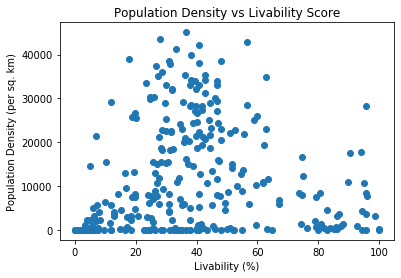

In [602]:
plt.plot(df_lscore1['lscore'],df_lscore1['Density'],'o')
plt.title('Population Density vs Livability Score')
plt.xlabel('Livability (%)')
plt.ylabel('Population Density (per sq. km)')
plt.savefig('Images\lscore_vs_popden.png')

In [440]:
df['Area_km2'].sum()

784.8234481693579

In [443]:
a1=df['Area_km2'].sum()/len(df)

In [450]:
math.sqrt(a1/3.14)

0.8796702402526768

# Machine Learning Model


In [58]:
from sklearn.neighbors import KNeighborsRegressor as KNR
from sklearn.model_selection import train_test_split as ttsplit
from sklearn import preprocessing
from sklearn.linear_model import LinearRegression as LR
from sklearn.metrics import r2_score, f1_score, accuracy_score
from sklearn.metrics import mean_squared_error as mse

In [633]:
X=df_lscore1[CATNAME]
y=df['Density']

In [634]:
X = preprocessing.StandardScaler().fit(X).transform(X.astype(float))

In [635]:
Xtr, Xtst, ytr, ytst = ttsplit( X, y, test_size=0.2, random_state=4)

In [626]:
lr=LR()

In [684]:
lr.fit(Xtr,ytr)

LinearRegression(copy_X=True, fit_intercept=True, n_jobs=None, normalize=False)

In [687]:
yh_lin=lr.predict(Xtr)

In [688]:
r2_score(ytr,yh_lin)

0.12116226605056901

In [646]:
df_lscore1['Predicted_LR']=yh_lin

In [647]:
sg_map = folium.Map(location=[1.32,103.82], zoom_start=11,tiles='Stamen Terrain')

sg_map.choropleth(
    geo_data=subzone_geo,
    data=df_lscore1,
    columns=['Subzone', 'Predicted'],
    key_on='feature.properties.name',
    fill_color='OrRd',
    fill_opacity=0.8, 
    line_opacity=0.2,
    legend_name='Singapore Population Density : Machine Learning Model'
)

sg_map

C:\Users\kssuj\Anaconda3\lib\site-packages\folium\folium.py:415: FutureWarning: The choropleth  method has been deprecated. Instead use the new Choropleth class, which has the same arguments. See the example notebook 'GeoJSON_and_choropleth' for how to do this.
  FutureWarning


### k-Nearest Neighbour Regression

In [648]:
Knr=KNR(n_neighbors=2)

In [484]:
Knr.fit(Xtr,ytr)

KNeighborsRegressor(algorithm='auto', leaf_size=30, metric='minkowski',
                    metric_params=None, n_jobs=None, n_neighbors=30, p=2,
                    weights='uniform')

In [485]:
yh=Knr.predict(Xtst)

In [481]:
r2_score(ytst,yh)

0.3871299123252576

In [486]:
mse(ytst,yh)

114891426.13512564

['max r2 = ', 0.4345356791108995, 'for n = ', 2]


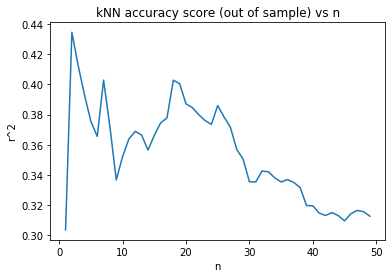

In [597]:
r2=[]
n=[]
for i in range(1,50):
    Knr=KNR(n_neighbors=i)
    Knr.fit(Xtr,ytr)
    yh=Knr.predict(Xtst)
    r2.append(r2_score(ytst,yh))
    n.append(i)
plt.plot(n,r2)
plt.title('kNN accuracy score (out of sample) vs n')
plt.xlabel('n')
plt.ylabel('r^2')
plt.savefig('Images\kNN_accuracy_out.png')
print(['max r2 = ',max(r2),'for n = ',n[np.argmax(r2)]])

In [593]:
plt.savefig('Images\kNN_accuracy_out.png')

<Figure size 432x288 with 0 Axes>

In [689]:
Knr=KNR(n_neighbors=2)

In [564]:
Knr.fit(Xtst,ytst)

KNeighborsRegressor(algorithm='auto', leaf_size=30, metric='minkowski',
                    metric_params=None, n_jobs=None, n_neighbors=2, p=2,
                    weights='uniform')

In [565]:
yh=Knr.predict(X)

In [566]:
r2_score(y,yh)

0.0795327134867585

In [567]:
df_lscore1['Predicted']=yh

In [604]:
sg_map = folium.Map(location=[1.32,103.82], zoom_start=11,tiles='Stamen Terrain')

sg_map.choropleth(
    geo_data=subzone_geo,
    data=df_lscore1,
    columns=['Subzone', 'Predicted'],
    key_on='feature.properties.name',
    fill_color='OrRd',
    fill_opacity=0.8, 
    line_opacity=0.2,
    legend_name='Singapore Population Density : Machine Learning Model'
)

sg_map

In [605]:
sg_map.save('Images\sg_map_mlout.html')

In [649]:
Knr=KNR(n_neighbors=2)

In [690]:
Knr.fit(X,y)

KNeighborsRegressor(algorithm='auto', leaf_size=30, metric='minkowski',
                    metric_params=None, n_jobs=None, n_neighbors=2, p=2,
                    weights='uniform')

In [691]:
yh_knn=Knr.predict(X)

In [655]:
r2_score(y,yh_knn)

0.6952293849965175

['max r2 = ', 0.8340306388909586, 'for n = ', 1]


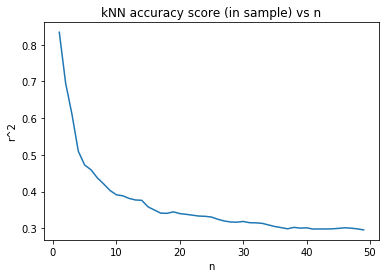

In [595]:
r2=[]
n=[]
for i in range(1,50):
    Knr=KNR(n_neighbors=i)
    Knr.fit(X,y)
    yh=Knr.predict(X)
    r2.append(r2_score(y,yh))
    n.append(i)
plt.plot(n,r2)
plt.title('kNN accuracy score (in sample) vs n')
plt.xlabel('n')
plt.ylabel('r^2')
plt.savefig('Images\kNN_accuracy_in.png')
print(['max r2 = ',max(r2),'for n = ',n[np.argmax(r2)]])

In [612]:
df_lscore1['Predicted']=yh

In [692]:
sg_map = folium.Map(location=[1.32,103.82], zoom_start=11,tiles='Stamen Terrain')

sg_map.choropleth(
    geo_data=subzone_geo,
    data=df_lscore1,
    columns=['Subzone', 'Predicted'],
    key_on='feature.properties.name',
    fill_color='OrRd',
    fill_opacity=0.8, 
    line_opacity=0.2,
    legend_name='Singapore Population Density : Machine Learning Model'
)

sg_map

C:\Users\kssuj\Anaconda3\lib\site-packages\folium\folium.py:415: FutureWarning: The choropleth  method has been deprecated. Instead use the new Choropleth class, which has the same arguments. See the example notebook 'GeoJSON_and_choropleth' for how to do this.
  FutureWarning


In [615]:
sg_map.save('Images\sg_map_mlin.html')

In [656]:
xpl=df_lscore1['Subzone']

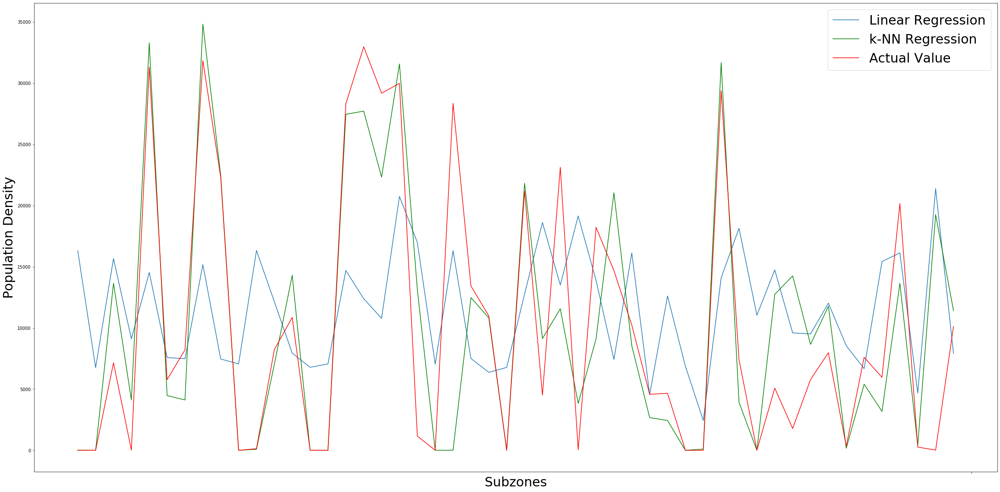

In [680]:
plt.figure(figsize=(40,20))
plt.plot(xpl[50:100],yh_lin[50:100])
plt.plot(xpl[50:100],yh_knn[50:100],'g')
plt.plot(xpl[50:100],y[50:100],'r')

plt.xlabel('Subzones',fontsize=30)
plt.ylabel('Population Density',fontsize=30)
plt.xticks('')
plt.legend(['Linear Regression', 'k-NN Regression','Actual Value'],fontsize=30)
plt.savefig('Images\comparison.png')